In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import os

import glob

import pandas as pd
import numpy as np
import random
import os
from pathlib import Path
from functools import partial

import torch
from torch import nn
import matplotlib.pyplot as plt

import cv2
import os

import glob
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from torch import nn

import cv2
from fastai.widgets.image_cleaner import *
from fastai.vision import *
from fastai.metrics import error_rate
import warnings

warnings.filterwarnings("ignore")

In [2]:
class Precision(Callback):
    
    def on_epoch_begin(self, **kwargs):
        self.correct, self.total = 0, 0
    
    def on_batch_end(self, last_output, last_target, **kwargs):
        preds = last_output.argmax(1)
        self.correct += ((preds==0) * (last_target==0)).float().sum()
        self.total += (preds==0).float().sum()
    
    def on_epoch_end(self, last_metrics, **kwargs):
        return add_metrics(last_metrics, self.correct/self.total)
    
class AUROC(Callback):
    "Computes the area under the curve (AUC) score based on the receiver operator characteristic (ROC) curve. Restricted to binary classification tasks."
    def on_epoch_begin(self, **kwargs):
        self.targs, self.preds = LongTensor([]), Tensor([])
        
    def on_batch_end(self, last_output:Tensor, last_target:Tensor, **kwargs):
        last_output = F.softmax(last_output, dim=1)[:,-1]
        self.preds = torch.cat((self.preds, last_output.cpu()))
        self.targs = torch.cat((self.targs, last_target.cpu().long()))
    
    def on_epoch_end(self, last_metrics, **kwargs):
        return add_metrics(last_metrics, auc_roc_score(self.preds, self.targs))
    

In [3]:
def extract_patches(img_name, patch_size, directory_path):
    src_img = plt.imread(str(directory_path / img_name))
    patches = []
    
    img_height = src_img.shape[0]
    img_width = src_img.shape[1]

    h_indexes = get_patch_indexes(img_height, patch_size)
    w_indexes = get_patch_indexes(img_width, patch_size)

    for h_i, h in enumerate(h_indexes):    
        for w_i, w in enumerate(w_indexes):
            try:
                patch = src_img[h: h+patch_size, w: w+patch_size, :]
            except IndexError:
                patch = src_img[h: h+patch_size, w: w+patch_size]

            patches.append(patch)
    
    return patches


def get_patch_indexes(img_size, patch_size):
    patches_n = img_size / patch_size
    remainder = img_size % patch_size
    
    # get list of full patches
    indexes = list(range(0, int(patches_n)))
    
    # last patch will start from the end of previous and to the end of the image
    if remainder:
        indexes.append(patches_n - 1)
    
    return [int(i * patch_size) for i in indexes]

In [4]:
input_dir = Path('data')
dataset_dir = input_dir / 'patches'
test_path= dataset_dir/'test'

In [5]:
bs= 256
image_size =256
df = pd.read_csv(dataset_dir/'cleaned.csv', header='infer')
np.random.seed(42)
tfms=get_transforms(max_rotate=None, max_zoom=1, max_warp=None)

data = ImageList.from_df(df= df, path=dataset_dir, cols='name').\
random_split_by_pct(valid_pct=0.2).label_from_df(cols='label').\
transform(tfms=tfms, size=image_size).databunch(bs=bs, num_workers=6).normalize()



In [7]:
df.head()

,name,label
0,smoke/1855_mask_4.png,smoke
1,smoke/5957_mask_7.png,smoke
2,smoke/4825_mask_9.png,smoke
3,smoke/6018_mask_10.png,smoke
4,smoke/2284_mask_9.png,smoke


In [ ]:

learn = cnn_learner(data, models.resnet50, metrics=[accuracy, Precision(), AUROC()], callback_fns=ShowGraph)
learn.to_fp16()
learn.crit = nn.CrossEntropyLoss()


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


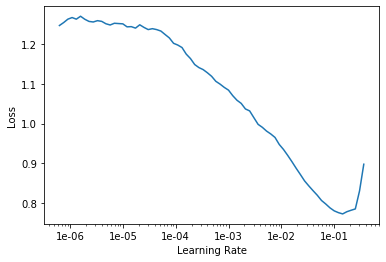

In [10]:
learn.to_fp16();
learn.lr_find()
learn.recorder.plot()

epoch,train_loss,valid_loss,accuracy,precision,auroc,time
0,0.421136,0.262119,0.902240,0.937480,0.942887,02:08
1,0.245924,0.210789,0.916146,0.933292,0.957562,02:09
2,0.196429,0.176152,0.926389,0.940644,0.970346,02:08
3,0.168131,0.163997,0.931718,0.953419,0.975480,02:08
4,0.154437,0.159429,0.935132,0.944767,0.977112,02:09
5,0.136419,0.156992,0.935382,0.954888,0.978166,02:11
6,0.127134,0.150092,0.936797,0.963715,0.980445,02:09
7,0.105966,0.151241,0.939462,0.960273,0.980981,02:08
8,0.102207,0.148889,0.939962,0.959612,0.981252,02:09
9,0.090996,0.149810,0.940212,0.961000,0.981146,02:08


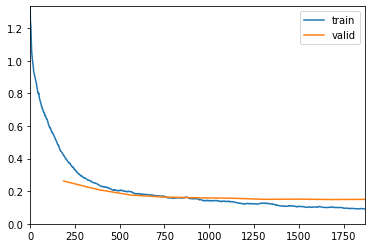

In [11]:

learn.fit_one_cycle(10)


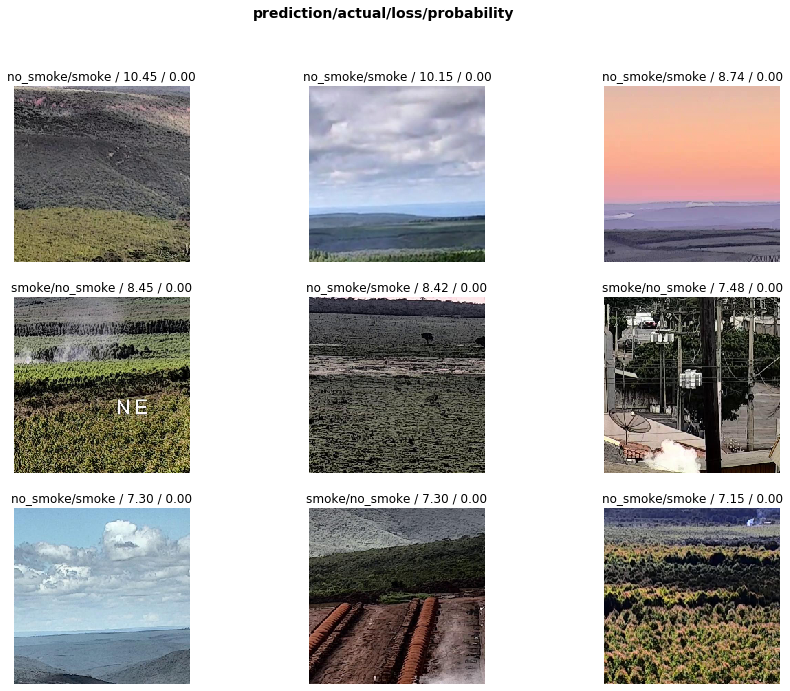

In [12]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_top_losses(9, figsize=(15,11))

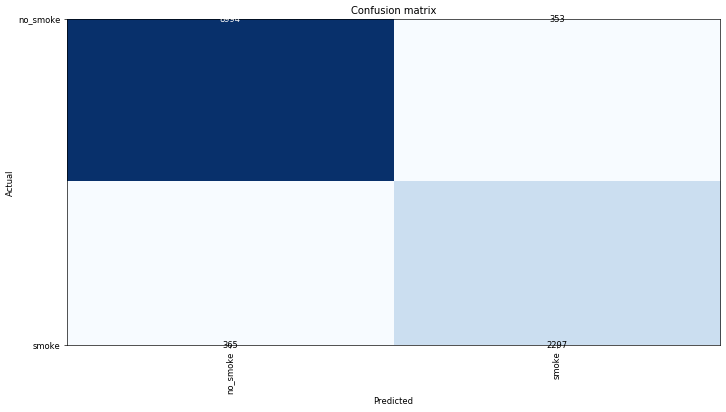

In [13]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


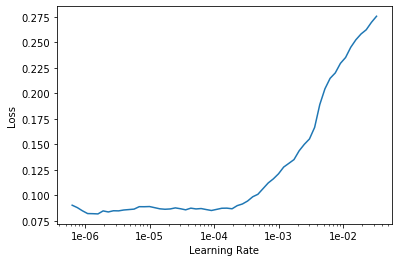

In [14]:
learn.unfreeze()
learn.lr_find()
learn.recorder.plot()

epoch,train_loss,valid_loss,accuracy,precision,auroc,time
0,0.094092,0.149987,0.940794,0.958776,0.981197,02:23


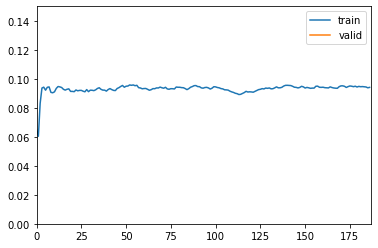

In [15]:
learn.fit_one_cycle(1,slice(1e-7, 1e-5))


In [16]:
learn.save('resnet50')
learn.export()

In [17]:

interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

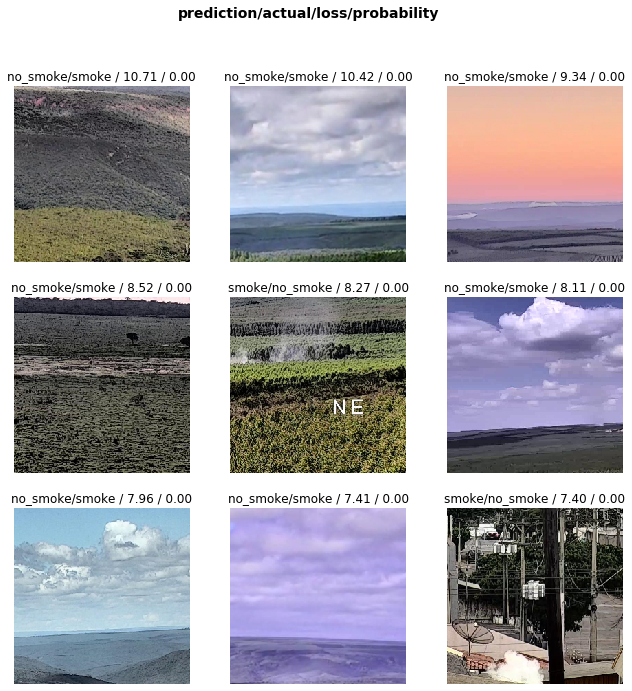

In [20]:
interp.plot_top_losses(9, figsize=(11,11))


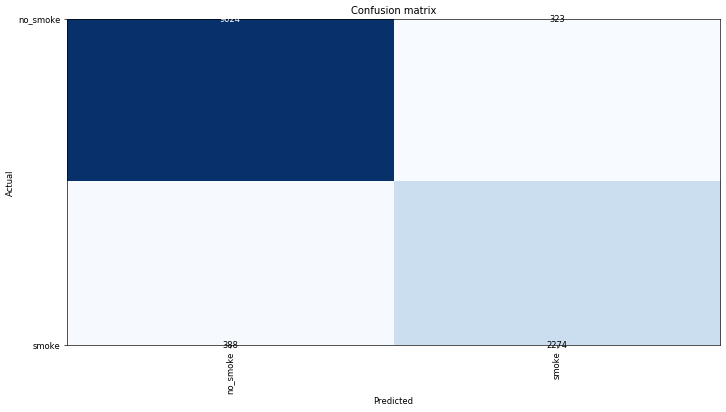

In [21]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)


In [6]:

def inferance(model_export_dir , img_path):
    img=open_image(img_path)
    learn = load_learner(dataset_dir )
    learn.to_fp16();
    predicted_class, predicted_index, outputs = learn.predict(img)          
    img.show(y=learn.predict(img)[0])
    return str(predicted_class)

    

In [8]:
image_list=[]
for filename in glob.glob('data/OpenFire/images/*.jpg'): 
    image_list.append(filename)

In [9]:
unet_export_dir = Path('data/unet')
path = untar_data('data/seg_data')
mask_train_path= path/'masks'
train_path = path/'images'
test_images = path/'test'

get_y_fn = lambda x :mask_train_path / str(x.stem+'.png') # Fixed
codes =['No-Smoke', 'smoke']
image_size= 256
size = [image_size,image_size]
bs =64
class SegLabelListCustom(SegmentationLabelList):
    def open(self, fn): return open_mask(fn, div=True)

class SegItemListCustom(SegmentationItemList):
    _label_cls = SegLabelListCustom

seg_data = (SegItemListCustom.from_folder(train_path)
        .split_by_rand_pct()
        .label_from_func(get_y_fn, classes=codes)
        .transform(get_transforms(), tfm_y=True, size=size)
        .databunch(bs=bs).normalize(imagenet_stats))

unet_learn = unet_learner(seg_data, models.resnet34)

def segmentation_inferance(unet_export_dir , img_path):
    img=open_image(img_path)
    unet_learn = load_learner(unet_export_dir)
    unet_learn.to_fp16();
    predicted_class = unet_learn.predict(img)          
    img.show(y=unet_learn.predict(img)[0])
    return predicted_class


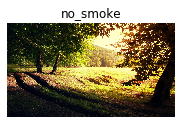

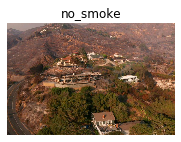

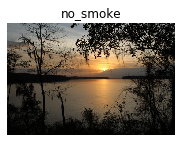

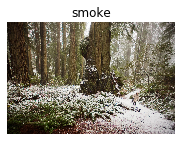

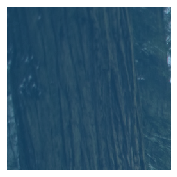

...

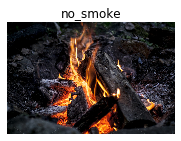

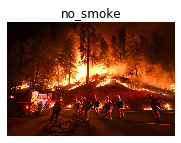

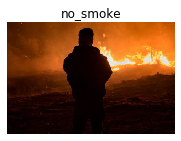

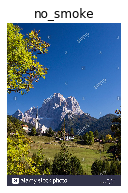

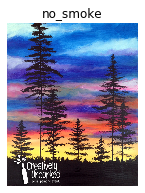

In [10]:
test_list= random.sample(image_list, 300)
for img in test_list:
    if inferance(dataset_dir,img ) == 'smoke':
        segmentation_inferance(unet_export_dir,img )